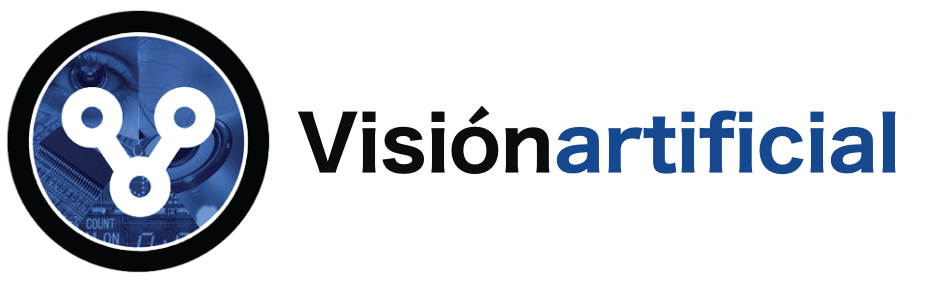

# OpenCV 

### para a materia de Visión Artificial do Grao de Robótica. EPSE de Lugo.

<hr style = "border: none; height: 4px; background-color: # D3D3D3" />

<h1 style="font-size:30px;">Detección de movemento en vídeo</h1> 

Neste caderno, imos demostrar como detectar movemento en vídeos que conteñan obxectos en primeiro plano móbiles. Os temas tratados inclúen:

* Usando un modelo de subtracción de fondo para illar obxectos en movemento en primeiro plano (creando unha máscara de primeiro plano)
* A "erosión", como operación morfolóxica, para eliminar o ruído da máscara de primeiro plano.

Os modelos de subtracción de fondo funcionan construíndo un modelo estatístico do fondo da escena baseado nos fotogramas anteriores do fluxo de vídeo. O modelo pódese usar entón para crear unha máscara de primeiro plano comparando o frame actual co modelo do fondo. Se o frame actual é da "mesma" escena de fondo, entón a máscara de primeiro plano debería estar, teoricamente, totalmente negra. Se algo cambia na escena, a máscara detectará os cambios e rexistraos como intensidades de píxeles distintas de cero, onde a intensidade da máscara é unha medida do cambio na escena. Polo tanto, a máscara pode usarse para identificar o movemento nun fluxo de vídeo. Neste caderno identificaremos o movemento debuxando un rectángulo delimitador que englobe todos os píxeles distintos de cero da máscara.

A erosión é unha operación morfolóxica que ten moitos usos no procesado de imaxes. Un deles é eliminar pequenas cantidades de ruído en imaxes binarias.



# 1. Visualizamos o vídeo

In [1]:
import cv2
import numpy as np


In [2]:
from moviepy.editor import VideoFileClip

input_video = '../data/motion_test.mp4'

# Cargamos o video para visualizalo. 
clip = VideoFileClip(input_video)
clip.ipython_display(width = 800)

t:   2%|▏         | 11/600 [00:00<00:05, 105.09it/s, now=None]

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


# 2. Marco de traballo e secuencia de pasos

* Creamos un modelo estatístico do fondo da escena usando **`createBackgroundSubtractorKNN()`**
* Para cada fotograma de vídeo:
     * Comparamos o frame actual co modelo de fondo para crear unha máscara de primeiro plano usando o método **`apply()`**
     * Aplica erosión á máscara para reducir o ruído empregando **`erode()`**
     * Busca o rectángulo delimitador que abarca todos os puntos distintos de cero na máscara con **`boundingRect()`**


## 2.1 Vista previa do fluxo de traballo

### <font style="color:rgb(50,120,230)">Escena estática (sen movemento no vídeo)</font>

O frame superior esquerdo da figura 1 (máscara de primeiro plano) é case totalmente negro, a excepción duns poucos píxeles que teñen unha intensidade distinta de cero. Aínda que nada, aparentemente, está cambiando na escena dun fotograma a outro, os frames adxacentes no fluxo de vídeo poden ter diferenzas moi sutís debido á forma en que o sensor da cámara percibe a escena, ou a propia escena pode estar cambiando lixeiramente debido ás variacións de iluminación: reflexos, sombras, etc. O rectángulo de delimitación vermello que se mostra á dereita engloba todos os píxeles distintos de cero da máscara. Ten en conta que algúns píxeles distintos de cero nin sequera son visibles xa que un só píxel é extremadamente pequeno nesta imaxe de alta resolución.

O fotograma inferior esquerdo (máscara de primeiro plano erosionada) mostra o efecto de aplicar a erosión á máscara, eliminando o ruído por completo.


<br />
<figure>
  <img src="visuais/c0-m4-Still-2sec-03.jpg" width=800/>
  <center><figcaption>Fig 1: máscaras de primeiro plano (sen e con erosión) dunha escea estática </figcaption></center>
</figure>

Os seguintes exemplos ilustran como funciona a erosión. Comezamos definindo un pequeno elemento estrutural chamado kernel. Neste exemplo, empregamos un núcleo 3x3. O centro do núcleo (punto amarelo) colócase sobre cada píxel ***p*** da imaxe orixinal. En cada localización, ***p***, examinamos os píxeles circundantes debaixo do núcleo. Se TODOS os píxeles do núcleo están sobre píxeles branco do obxecto, entón o píxel ***p*** da imaxe erosionada permanece branco. En caso contrario, o píxel da imaxe erosionada ponse a negro.

<br />
<figure>
  <img src="visuais/c0-m4-Erosion-03.jpg" width=800/>
  <center><figcaption>Fig 2: Ilustración da operación de erosión </figcaption></center>
</figure>

### <font style="color:rgb(50,120,230)">Escena dinámica (movemento obvio no vídeo)</font>
O fotograma superior esquerdo (máscara de primeiro plano) está detectando grandes cambios na escena debido ao movemento do libro, pero a máscara tamén contén moito ruído de fondo por cambios sutís de iluminación (por exemplo, sombras).

O fotograma inferior esquerdo (máscara de primeiro plano erosionada) mostra o efecto de aplicar a erosión á máscara. Suprimiuse a maior parte do ruído asociado ás sombras.


<img src="visuais/c0-m4-Feature-Image-03a.jpg" width=800/>
<img src="visuais/c0-m4-Feature-Image-03b.jpg" width=800/>


# 3. Resumo da documentación

## 3.1 Subtractor de fondo KNN

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

**`createBackgroundSubtractorKNN()`** crea o subtractor de fondo KNN.

### <font color="green">Sintaxe da función </font>
``` python
retval = cv2.createBackgroundSubtractorKNN([, history[, dist2Threshold[, detectShadows]]])	
```

`retval`: obxecto subtractor de fondo KNN.

A función ten 3 argumentos opcionais:

1. `history` Amplitude temporal da historia.
2. `dist2Threshold` limiar sobre a distancia ao cadrado entre o píxel e a mostra para decidir se un píxel está preto desa mostra. Este parámetro non afecta á actualización en segundo plano do fondo.
3. `detectShadows` Se é verdadeiro, o algoritmo detectará sombras e marcaraas. Diminúe un pouco a velocidade, polo que se non precisa esta función, configura o parámetro en false.


### <font color="green">Documentación en OpenCV</font>

[**`createBackgroundSubtractorKNN()`**](https://docs.opencv.org/4.5.2/de/de1/group__video__motion.html#gac9be925771f805b6fdb614ec2292006d)

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

## 3.2 Aplicando o subtractor de fondo

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

**`apply()`** calcula unha máscara de primeiro plano.

### <font color="green">Sintaxe da función </font>
``` python
fgmask = cv2.BackgroundSubtractor.apply(image[, fgmask[, learningRate]])	
```

A función ten **1 argumento de entrada obrigatorio** e 2 flags opcionais:

1. `image` Seguinte fotograma.
2. `fgmask` A máscara do primeiro plano como imaxe binaria de 8 bits.
3. `learningRate` o valor entre 0 e 1 que indica a rapidez coa que aprendeu o modelo de fondo. O valor do parámetro negativo fai que o algoritmo use unha taxa de aprendizaxe escollida automaticamente. 0 significa que o modelo de fondo non se actualiza en absoluto, 1 significa que o modelo de fondo está aprendendo continuamente e ten en conta o último fotograma.


### <font color="green">Documentación de OpenCV</font>

[**`apply()`**](https://docs.opencv.org/4.5.2/d7/df6/classcv_1_1BackgroundSubtractor.html#aa735e76f7069b3fa9c3f32395f9ccd21)<br>

<hr style="border:none; height: 4px; background-color:#D3D3D3" />


## 3.3 Erosión

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

**`erode()`** erosiona unha imaxe mediante un elemento estruturante específico.

### <font style = "color:rgb(8,133,37)">Sintaxe da función</font>
``` python
dst = cv2.erode(src, kernel[, dst[, anchor[, iterations[, borderType[, borderValue]]]]])	
```

`dst`: imaxe de saída do mesmo tamaño e tipo que src.

A función ten **2 argumentos de entrada obrigatorios**:

1. `src` imaxe de entrada; o número de canles pode ser arbitrario, pero a profundidade debe ser unha das seguintes CV_8U, CV_16U, CV_16S, CV_32F or CV_64F.
2. `kernel`	elemento estrutural utilizado para a erosión; se o elemento = Mat(), utilízase un elemento de estrutural rectangular de 3 x 3. Núcleos distintos pódense crear usando getStructuringElement.


### <font color="green">Documentación de OpenCV</font>

[**`erode()`**](https://docs.opencv.org/3.4/d4/d86/group__imgproc__filter.html#gaeb1e0c1033e3f6b891a25d0511362aeb)<br>

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

## 3.4 findNonZero

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

**`findNonZero()`** Devolve a lista de localizacións de píxeles distintos de cero.


### <font color="green">Sintaxe da función</font>
``` python
retval = cv2.findNonZero(src)	
```

A función ten **1 argumento de entrada obrigatorio**:

1. `src` imaxe cunha única canle.

### <font color="green">Documentación de OpenCV</font>

[**`findNonZero()`**](https://docs.opencv.org/4.5.2/d2/de8/group__core__array.html#gaed7df59a3539b4cc0fe5c9c8d7586190) <br>

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

## 3.5 Rectángulo delimitador

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

**`boundingRect()`** calcula e devolve o rectángulo de delimitación superior á dereita mínimo para o conxunto de puntos especificado ou píxeles distintos de cero da imaxe en escala de grises.

### <font color="green">Sintaxe da función </font>
``` python
retval = cv2.boundingRect(array)	

retval é unha tupla que contén catro valores: (x, y, w, h)
    
    (x,y) son as coordenadas da esquina superior esquerda do rectángulo delimitador
    (w,h) son o ancho e o alto do rectángulo delimitador
    
Tamén se pode chamar a función para devolver explícitamente os valores individuais:
    
x, y, w, h  = cv2.boundingRect(array)  
        
```

A función ten **1 argumento de entrada obrigatorio**:

1. `array` Introduza unha imaxe en escala de grises ou un conxunto de puntos 2D almacenados en std::vector ou [Mat](https://docs.opencv.org/4.5.2/d3/d63/classcv_1_1Mat.html).

### <font color="green">Documentación de OpenCV</font>

[**`boundingRect()`**](https://docs.opencv.org/4.5.2/d3/dc0/group__imgproc__shape.html#ga103fcbda2f540f3ef1c042d6a9b35ac7) <br>

<hr style="border:none; height: 4px; background-color:#D3D3D3" />

# 4. Crea obxectos de captura de vídeo e video Writer

In [3]:
input_video = '../data/motion_test.mp4'
video_cap = cv2.VideoCapture(input_video)
if not video_cap.isOpened():
    print('Non atopo o video: ' + input_video)

In [4]:
#capturamos as propiedades do video de entrada para logo escribir a 
# saida do meu algoritmo nun video coas mesmas propiedades
frame_w = int(video_cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_h = int(video_cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(video_cap.get(cv2.CAP_PROP_FPS))

size = (frame_w, frame_h)
size_quad = (int(2*frame_w), int(2*frame_h))

video_out_quad = cv2.VideoWriter('video_out_quad.avi', cv2.VideoWriter_fourcc(*'XVID'), fps, size_quad)

# 5. Execución e Análise

### <font style="color:rgb(50,120,230)">Función conveniente para anotar fotogramas de vídeo</font>

In [5]:
def drawBannerText(frame, text, banner_height_percent = 0.08, font_scale = 0.8, text_color = (0, 255, 0), 
                   font_thickness = 2):
    # Debuxa un banner negro na parte superior do marco da imaxe.
     # ollo: establece a altura do banner como unha porcentaxe da altura do cadro.
    banner_height = int(banner_height_percent * frame.shape[0])
    cv2.rectangle(frame, (0, 0), (frame.shape[1], banner_height), (0, 0, 0), thickness = -1)

    # debuxamos o banner.
    left_offset = 20
    location = (left_offset, int(10 + (banner_height_percent * frame.shape[0]) / 2))
    cv2.putText(frame, text, location, cv2.FONT_HERSHEY_SIMPLEX, font_scale, text_color, 
                font_thickness, cv2.LINE_AA)

### <font style="color:rgb(50,120,230)">Crea un obxecto de subtracción de fondo</font>

In [6]:
bg_sub = cv2.createBackgroundSubtractorKNN(history = 200)

### <font style="color:rgb(50,120,230)">Vídeo do proceso</font>

In [7]:
ksize = (5, 5)
red = (0, 0, 255)
yellow = (0, 255, 255)

# Vista cuádruple que se construirá.
#------------------------------------
# frame_fg_mask       :  frame
# frame_fg_mask_erode :  frame_erode
#------------------------------------

while True:
    ret, frame = video_cap.read()

    if frame is None:
        break
    else:
        frame_erode = frame.copy()

    # Paso 1: Área de movemento baseada na máscara de primeiro plano.
    fg_mask = bg_sub.apply(frame)
    motion_area = cv2.findNonZero(fg_mask)
    x, y, w, h = cv2.boundingRect(motion_area)

    # Paso 2: Área de movemento baseada na máscara de primeiro plano (con erosión)
    fg_mask_erode = cv2.erode(fg_mask, np.ones(ksize, np.uint8))
    motion_area_erode = cv2.findNonZero(fg_mask_erode)
    xe, ye, we, he = cv2.boundingRect(motion_area_erode)

    # Debuxa un cadro delimitador para a área de movemento baseándose na máscara de primeiro plano
    if motion_area is not None:
        cv2.rectangle(frame, (x, y), (x + w, y + h), red, thickness = 6)

    # Debuxa un cadro delimitador para a área de movemento baseándose na máscara de primeiro plano (con erosión)
    if motion_area_erode is not None:
        cv2.rectangle(frame_erode, (xe, ye), (xe + we, ye + he), red, thickness = 6)

    # Converte máscaras de primeiro plano en cores para que poidamos construír un vídeo composto con anotacións de cores.
    frame_fg_mask = cv2.cvtColor(fg_mask, cv2.COLOR_GRAY2BGR)
    frame_fg_mask_erode= cv2.cvtColor(fg_mask_erode, cv2.COLOR_GRAY2BGR)

    # Anota cada fotograma de vídeo.
    drawBannerText(frame_fg_mask, 'Mascara de primeiro plano')
    drawBannerText(frame_fg_mask_erode, 'Mascara de primeiro plano erosionada')

    # Construimos a vista cuadruple apilando as imaxes no orde desexado
    frame_top = np.hstack([frame_fg_mask, frame])
    frame_bot = np.hstack([frame_fg_mask_erode, frame_erode])
    frame_composite = np.vstack([frame_top, frame_bot])

    # Crea vídeo composto con resultados intermedios (cuadrícula cuádruple).
    fc_h, fc_w, _= frame_composite.shape
    cv2.line(frame_composite, (0, int(fc_h/2)), (fc_w, int(fc_h/2)), yellow, thickness=1, lineType=cv2.LINE_AA)

    # A disco!.
    video_out_quad.write(frame_composite)

video_cap.release()
video_out_quad.release()

In [8]:
input_video = './video_out_quad.avi'

# Cargando o resultado obtido 
clip = VideoFileClip(input_video)
clip.ipython_display(width=1000)

t:   1%|          | 5/600 [00:00<00:11, 49.81it/s, now=None]

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


### <font style="color:rgb(50,120,230)"> Case 1:bg_sub = cv2.createBackgroundSubtractorKNN (history = 200)</font>

Ten en conta que no fotograma superior, o libro e a man aínda están en movemento. O rectángulo delimitador engloba tamén as sombras que quedan despois da erosión. No fotograma inferior (despois de colocar o libro), só a man está en movemento. As sombras que persisten na colocación do libro son aprendidas polo modelo como parte do fondo e xa non se identifican como movemento asociado ao primeiro plano.

<img src="visuais/c0-m4-Feature-Image-03c.jpg" width=800/>
<img src="visuais/c0-m4-Feature-Image-03d.jpg" width=800/>

### <font style="color:rgb(50,120,230)">Case 2:bg_sub = cv2.createBackgroundSubtractorKNN (history = 400)</font>


No fotograma inferior xerouse o modelo de subtracción de fondo cun historial de 400 fotogramas (vs 200 anterior). Polo tanto, o modelo ten unha memoria máis longa para aprender o fondo da  escena. Polo tanto, aínda que o libro xa non se move, segue valorando o libro como un obxecto de primeiro plano.

<img src="visuais/c0-m4-Feature-Image-03e.jpg" width=800/>